In [1]:
import torch
import os
import sys
import copy

In [2]:
import matplotlib.pyplot as plt
import geopandas as gpd

In [3]:
import numpy as np
import networkx as nx

In [4]:
import pandas as pd

In [5]:
from mpl_toolkits.mplot3d import Axes3D

In [6]:
import wandb

In [7]:
import numpy as np
import pandas as pd

def cart2pol(x, y):
    rho = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return(rho, phi)

In [30]:
def graphplot(rebuilding_info, edges, bins=50):
    """This is meant to input graph footprints, nodes, edges and output a density plot of distances"""
    buildinggeoms = rebuilding_info['footprints'].geometry.centroid[edges[0]].reset_index(drop=True)
    nodegeoms = rebuilding_info['node_data'].geometry[edges[1]].reset_index(drop=True)
    xs = buildinggeoms.geometry.x - nodegeoms.geometry.x
    ys = buildinggeoms.geometry.y - nodegeoms.geometry.y
    
    buildingdistance_df = pd.DataFrame({'building_id':edges[0], 'x': xs, 'y': ys})
    buildingdistance_df['rho'], buildingdistance_df['phi'] = cart2pol(buildingdistance_df.x, buildingdistance_df.y)
    z, azm, rad, _ = plt.hist2d(buildingdistance_df['phi'], buildingdistance_df['rho'], bins=bins)
    
    r, th = np.meshgrid(rad, azm)
    fig = plt.figure()
    ax = Axes3D(fig)

    plt.subplot(projection="polar")
    plt.pcolormesh(th, r, np.log(z))
    #plt.pcolormesh(th, z, r)

    plt.plot(azm, r, color='k', ls='none') 
    plt.grid()
    # plt.thetagrids([theta * 15 for theta in range(360//15)])
    # plt.rgrids(np.arange(0, 75, 25))
    return fig, buildingdistance_df

In [9]:
device = "cuda:0"

In [10]:
%load_ext autoreload
%autoreload 2

In [11]:
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

In [12]:
from src.cv import build_masks, crossvalidation

In [13]:
import torch_geometric.transforms as T
transform = T.Compose([T.ToUndirected(), T.AddSelfLoops()])

In [70]:
from src.graph_construction import graph
nycgraph, nyc_rebuild_info = graph(
    "new-york",
    neighbor_radius=100,
    building_buffer=40,
    test_percent=15
)

# nycgraph = transform(nycgraph)

In [71]:
nycgraph

HeteroData(
  pano={ x=[55201, 6] },
  footprint={
    x=[8164, 3],
    y=[19212],
    train_mask=[19212],
    test_mask=[19212]
  },
  (footprint, contains, pano)={ edge_index=[2, 144677] },
  (pano, links, pano)={ edge_index=[2, 2963391] },
  (pano, rev_contains, footprint)={ edge_index=[2, 144677] }
)

In [72]:
nyedges = nycgraph['footprint','contains','pano']['edge_index'].cpu().detach().numpy()

In [73]:
nycgraph['footprint'].x[np.array(nyc_rebuild_info['rebuild_idx'])]

tensor([[ 8.5136, 15.6631, 24.0239],
        [ 8.5136, 15.6631, 24.0239],
        [ 8.5136, 15.6631, 24.0239],
        ...,
        [ 7.9902, 15.8292, 22.8986],
        [ 8.9728, 15.8183, 22.9145],
        [ 8.9728, 15.8183, 22.9145]], device='cuda:0')

In [74]:
nyc_rebuild_info['footprints'].iloc[:2].explore()

/tmp/ipykernel_58454/858313422.py:17: RuntimeWarning: divide by zero encountered in log
  plt.pcolormesh(th, r, np.log(z))
/tmp/ipykernel_58454/858313422.py:17: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  plt.pcolormesh(th, r, np.log(z))


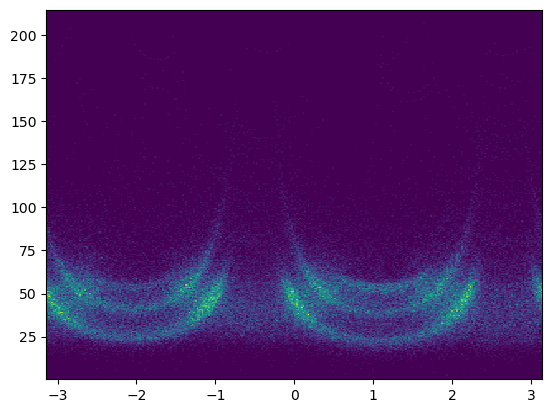

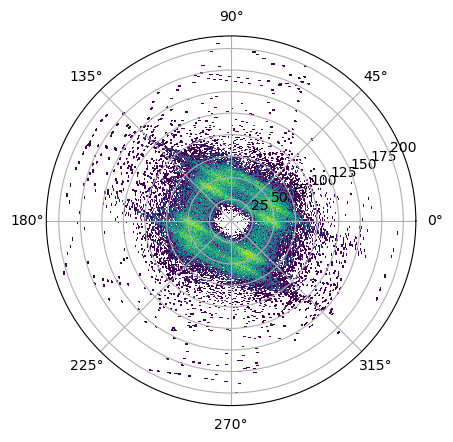

In [79]:
polarplot, building_info = graphplot(
    nyc_rebuild_info,
    nycgraph['footprint','contains','pano']['edge_index'].cpu().detach().numpy(), 
    bins = 300
)

In [80]:
building_details = building_info.groupby('building_id').apply(lambda x: x.count()).reset_index(drop=True)

In [81]:
building_info['sin'] = np.sin(building_info['phi'])
building_info['cos'] = np.cos(building_info['phi'])

In [82]:
building_details = building_info.groupby('building_id').apply(lambda x: x.mean()).reset_index(drop=True)
building_details

,building_id,x,y,rho,phi,sin,cos
0,0.0,6.857752,-5.075310,36.166503,0.437607,0.022296,0.189461
1,1.0,0.718024,2.814362,42.898566,-0.489972,-0.074890,-0.057326
2,2.0,-10.850575,4.041387,42.340914,-0.085455,0.166244,-0.248099
3,3.0,6.924417,-5.904699,46.445621,-0.635791,-0.136111,0.149393
4,4.0,9.336365,12.148826,31.411778,1.010385,0.476434,0.312182
...,...,...,...,...,...,...,...
8159,8159.0,-31.691656,64.630317,72.769646,2.027285,0.888145,-0.435830
8160,8160.0,-17.470379,-0.235531,33.889595,-0.305229,-0.146734,-0.485817
8161,8161.0,-1.632495,-18.136666,50.243483,-1.343468,-0.384630,0.027885
8162,8162.0,1.575978,5.152966,38.148611,0.932000,0.238217,0.073542


In [85]:
nyc_rebuild_info['footprints'].join(building_details).explore('sin')

In [ ]:
from src.graph_construction import graph
austingraph, austin_rebuild_info = graph(
    "austin",
    neighbor_radius=90,
    building_buffer=300,
    test_percent=15
)

In [ ]:
from src.graph_construction import graph
sfgraph, sf_rebuild_info = graph(
    "san-fransisco",
    neighbor_radius=70,
    building_buffer=50,
    test_percent=15
)

In [ ]:
sfgraph

In [ ]:
polarplot, building_info = graphplot(
    sf_rebuild_info,
    sfgraph['footprint','contains','pano']['edge_index'].cpu().detach().numpy(), 
    bins = 200
)

In [ ]:
nyc_rebuild_info['training_mask'].sum()

In [ ]:
(~nyc_rebuild_info['training_mask']).sum()

In [ ]:
nyc_mask = nyc_rebuild_info['training_mask'].cpu().numpy()
nyc_cvs = build_masks(
    nyc_mask, 
    n_cv = 5,
    n_val = 10
)

In [ ]:
loss_func = torch.nn.MSELoss()

In [ ]:
from sklearn.linear_model import LinearRegression

nyX = nycgraph['footprint'].x[nyc_rebuild_info['rebuild_idx']].cpu()
nyY = nyc_rebuild_info['recorded'].cpu()

cv_errors = []
for crossfold in nyc_cvs:

    nytrain, nyval = crossfold

    nytrain = nytrain[nyc_rebuild_info['rebuild_idx'].cpu().detach()]
    nyval = nyval[nyc_rebuild_info['rebuild_idx'].cpu().detach()]

    reg = LinearRegression().fit(nyX[nytrain], nyY[nytrain])
    fitpred = reg.predict(nyX[nyval])
    
    regloss = float(loss_func(torch.tensor(fitpred), nyY[nyval]))
    cv_errors.append(regloss)
    
linear_regerr = np.mean(cv_errors)

In [ ]:
linear_regerr

In [ ]:
nycgraph['footprint'].x

In [ ]:
config = {
    "custom_optimizer": torch.optim.Adam,
    "lr" : 5e-2,
    'epochs': 300,
    'linear_layers': 2,
    'hidden_channels': 8,
    'input_shape': nycgraph['footprint'].x.shape[1],
    'dropout': 0.3
}

In [ ]:
from src.model import NullModel

# input_shape = nycgraph['footprint'].x.shape[1]
nullmodel = NullModel(
    layers = config['linear_layers'],
    input_shape = config['input_shape'],
    hidden_channels = config['hidden_channels']
).to(device)

null_training_tensor, null_validation_tensor = crossvalidation(
    nullmodel,
    lambda: nullmodel(nycgraph['footprint'].x),
    nyc_cvs,
    nyc_rebuild_info,
    epochs = config['epochs'],
    custom_optimizer = config['custom_optimizer'],
    lr = config['lr'],
    config = config,
    log_model = False
)

In [ ]:
null_mean_tl = null_training_tensor.mean(axis=0)
null_mean_vl = null_validation_tensor.mean(axis=0)

plt.plot(null_mean_tl, label="Null Training")
plt.plot(null_mean_vl, label="Null Validation")

plt.legend()

# plt.yscale("log")
plt.ylim((0,5))

plt.show()

In [ ]:
config

In [ ]:
from src.model import CustomGAT

model = CustomGAT(
    hidden_channels = config['hidden_channels'], 
    out_channels=8,
    layers=2,
    heads=4,
    linear_layers = config['linear_layers'],
    input_shape = config['input_shape'],
    dropout = config['dropout']
).to(device)

default_modelstate = model.state_dict()

In [ ]:
graph_training_tensor, graph_validation_tensor = crossvalidation(
    model,
    lambda: model(nycgraph.x_dict, nycgraph.edge_index_dict),
    nyc_cvs,
    nyc_rebuild_info,
    epochs= config['epochs'],
    custom_optimizer = config['custom_optimizer'],
    lr = config['lr'],
    config=config,
    log_model=False
)

In [ ]:
mean_tl = graph_training_tensor.mean(axis=0)
std_tl = graph_training_tensor.std(axis=0)

mean_vl = graph_validation_tensor.mean(axis=0)
std_vl = graph_validation_tensor.std(axis=0)

plt.plot(mean_tl, label="Graph Training")
plt.plot(mean_vl, label="Graph Validation")
plt.legend()

# plt.yscale("log")
plt.ylim((0,2))

plt.show()

In [ ]:
nycfootprints = nyc_rebuild_info['footprints']
nycfootprints['logenergy'] = np.log(nycfootprints.energy)

# nycfootprints.explore('logenergy')

In [ ]:
domain = np.arange(0, len(mean_tl))

plt.plot(domain, mean_tl, label="Training")
plt.plot(domain, mean_vl, label="Validation", color="lightblue")
# plt.fill_between(domain, mean_vl + std_vl, mean_vl - std_vl, alpha=0.1)

plt.plot(domain, null_mean_tl, label="Null Training", color="indianred", linestyle='dashed')
plt.plot(domain, null_mean_vl, label="Null Validation", color="salmon", linestyle='dashed')

plt.hlines(linear_regerr, min(domain), max(domain), color='pink', label="linear regression")

plt.title(f"Loss Function with Training - lr: {config['lr']}")

plt.xlabel("Epoch")
plt.ylabel("Training Loss - MSE")
plt.legend()

plt.yscale("log")
plt.ylim((0,2.5))

plt.show()

In [ ]:
graph_improvement = (min(mean_vl) - min(null_mean_vl)) / min(null_mean_vl)
print("Improvement from Context: {:0.2f}%".format(100*graph_improvement))

In [ ]:
def relative_benefit(errors, threshold):
    count_pass = (errors <= threshold).sum()
    return float(100 * (count_pass / len(errors)))

In [ ]:
# now examining how this may generalize
with torch.no_grad():
    print("New York City")
    rebuilding_idx = nyc_rebuild_info['rebuild_idx'].cpu().numpy()

    linear_predictions = reg.predict(nycgraph['footprint'].x.cpu().numpy())[rebuilding_idx]
    null_predictions = nullmodel(nycgraph['footprint'].x).squeeze()[rebuilding_idx]
    estimates = model(nycgraph.x_dict, nycgraph.edge_index_dict).squeeze().detach()[rebuilding_idx]
    recorded = nyc_rebuild_info['recorded']

    linear_loss = loss_func(torch.tensor(linear_predictions).to(device), recorded)
    null_loss = loss_func(null_predictions, recorded)
    graph_loss = loss_func(estimates, recorded)
    
    print("Linear Loss:\t{:0.2f}".format(linear_loss))
    print("Null Loss:\t{:0.2f}".format(null_loss))
    print("Graph Loss:\t{:0.2f}".format(graph_loss))
    print("Improvement:\t{:0.2f}".format(100 * (graph_loss - null_loss)/null_loss))

In [ ]:
linmae = torch.abs(torch.exp(recorded) - torch.tensor(np.exp(linear_predictions)).to(device))
nullmae = torch.abs(torch.exp(recorded) - torch.exp(null_predictions))
graphmae = torch.abs(torch.exp(recorded) - torch.exp(estimates))

In [ ]:
threshold = 500

print(f"Relative Benefit:\t{relative_benefit(linmae, threshold)}")
print(f"Null Benefit:\t\t{relative_benefit(nullmae, threshold)}")
print(f"Graph Benefit:\t\t{relative_benefit(graphmae, threshold)}")

In [ ]:
torch.exp(null_predictions)

In [ ]:
nycgraph

In [ ]:
nylinks = nycgraph['footprint','contains','pano']['edge_index'].cpu().detach().numpy()

In [ ]:
nylinks[0]

In [ ]:
nycentroids = nyc_rebuild_info['footprints'].geometry

In [ ]:
gpd.GeoDataFrame({"id":nyc_rebuild_info['footprints']['id'], "geometry": nycentroids})

In [ ]:
buildinggeoms = nyc_rebuild_info['footprints'].geometry.centroid[nylinks[0]].reset_index(drop=True)
buildinggeoms

In [ ]:
nodegeoms = nyc_rebuild_info['node_data'].geometry[nylinks[1]].reset_index(drop=True)

In [ ]:
buildingdists = buildinggeoms.distance(nodegeoms, align=False)

In [ ]:
xs = buildinggeoms.geometry.x - nodegeoms.geometry.x
ys = buildinggeoms.geometry.y - nodegeoms.geometry.y

In [ ]:
buildingdistance_df = pd.DataFrame({'building_id':nylinks[0], 'x': xs, 'y': ys})
building_statistics = buildingdistance_df.groupby('building_id').mean().reset_index()

In [ ]:
import numpy as np
import pandas as pd

def cart2pol(x, y):
    rho = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return(rho, phi)

In [ ]:
def graphplot(rebuilding_info, edges, bins=50):
    """This is meant to input graph footprints, nodes, edges and output a density plot of distances"""
    buildinggeoms = rebuilding_info['footprints'].geometry.centroid[edges[0]].reset_index(drop=True)
    nodegeoms = rebuilding_info['node_data'].geometry[edges[1]].reset_index(drop=True)
    xs = buildinggeoms.geometry.x - nodegeoms.geometry.x
    ys = buildinggeoms.geometry.y - nodegeoms.geometry.y
    
    buildingdistance_df = pd.DataFrame({'building_id':edges[0], 'x': xs, 'y': ys})
    building_statistics = buildingdistance_df.groupby('building_id').mean().reset_index()
    building_statistics['rho'], building_statistics['phi'] = cart2pol(building_statistics.x, building_statistics.y)
    z, azm, rad, _ = plt.hist2d(building_statistics['phi'], building_statistics['rho'], bins=bins)
    
    r, th = np.meshgrid(rad, azm)
    fig = plt.figure()
    ax = Axes3D(fig)

    plt.subplot(projection="polar")
    plt.pcolormesh(th, r, z)
    #plt.pcolormesh(th, z, r)

    plt.plot(azm, r, color='k', ls='none') 
    plt.grid()
    plt.thetagrids([theta * 15 for theta in range(360//15)])
    plt.rgrids(np.arange(0, max(rad), 5000))
    return plt

In [ ]:
polarplot = graphplot(nyc_rebuild_info, nycgraph['footprint','contains','pano']['edge_index'].cpu().detach().numpy(), bins = 25)

In [ ]:
polarplot = graphplot(sf_rebuild_info, sfgraph['footprint','contains','pano']['edge_index'].cpu().detach().numpy(), bins = 25)

In [ ]:
building_statistics

In [ ]:
building_statistics['rho'], building_statistics['phi'] = cart2pol(building_statistics.x, building_statistics.y)

In [ ]:
rho

In [ ]:
building_statistics['phi'].hist(bins=200)

In [ ]:
import math
z, azm, rad, _ = plt.hist2d(building_statistics['phi'], building_statistics['rho'], bins=50)

In [ ]:
r, th = np.meshgrid(rad, azm)

In [ ]:
fig = plt.figure(dpi=200)
ax = fig.add_subplot(111, projection='polar')
ax.scatter(building_statistics['phi'], building_statistics['rho'], alpha=0.05, color='black')
plt.rgrids(np.arange(0, max(rad), 5000))

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

fig = plt.figure()
ax = Axes3D(fig)

plt.subplot(projection="polar")

plt.pcolormesh(th, r, z)
#plt.pcolormesh(th, z, r)

plt.plot(azm, r, color='k', ls='none') 
plt.grid()
plt.thetagrids([theta * 15 for theta in range(360//15)])
plt.rgrids(np.arange(0, max(rad), 5000))

plt.show()

In [ ]:
nyctestidx = (~nyc_rebuild_info['training_mask']).detach().cpu().numpy()
nyctestidx

In [ ]:
testidx = (~sf_rebuild_info['training_mask']).detach().cpu().numpy()
testidx

In [ ]:
nyc_rebuild_info.keys()

In [ ]:
nyctestidx.shape

In [ ]:
nyc_rebuild_info['footprints'].iloc[nyctestidx]

In [ ]:
# now examining how this may generalize
with torch.no_grad():
    print("San Fransisco")
    rebuilding_idx = sf_rebuild_info['rebuild_idx'][testidx]
    null_predictions = nullmodel(sfgraph['footprint'].x).squeeze()[testidx][rebuilding_idx]
    
    linear_predictions = reg.predict(sfgraph['footprint'].x.cpu().numpy())[testidx][rebuilding_idx]
    estimates = model(sfgraph.x_dict, sfgraph.edge_index_dict).squeeze().detach()[testidx][rebuilding_idx]
    recorded = sf_rebuild_info['recorded'][testidx]

    linear_loss = loss_func(torch.tensor(linear_predictions).to(device), recorded)
    null_loss = loss_func(null_predictions, recorded)
    graph_loss = loss_func(estimates, recorded)
    print("Linear Loss:\t{:0.2f}".format(linear_loss))
    print("Null Loss:\t{:0.2f}".format(null_loss))
    print("Graph Loss:\t{:0.2f}".format(graph_loss))
    print("Improvement:\t{:0.2f}".format(100 * (graph_loss - null_loss)/null_loss))

In [ ]:
with torch.no_grad():
    print("Austin Texas")
    rebuilding_idx = austin_rebuild_info['rebuild_idx'].cpu().numpy()
    null_predictions = nullmodel(austingraph['footprint'].x).squeeze()[rebuilding_idx]
    
    rebuilding_idx = austin_rebuild_info['rebuild_idx'].cpu().numpy()
    estimates = model(austingraph.x_dict, austingraph.edge_index_dict).squeeze().detach()[rebuilding_idx]
    recorded = austin_rebuild_info['recorded']
    
    null_loss = loss_func(null_predictions, recorded)
    graph_loss = loss_func(estimates, recorded)
    print("Null Loss:\t{:0.2f}".format(null_loss))
    print("Graph Loss:\t{:0.2f}".format(graph_loss))
    print("Improvement:\t{:0.2f}".format(100 * (graph_loss - null_loss)/null_loss))

In [ ]:
trainmask

In [ ]:
valmask

In [ ]:
optim = config['custom_optimizer']
optim(model.parameters())

In [ ]:
from src.trainer import trainer
from src.cv import reset_model

model.load_state_dict(default_modelstate)

trainmask = nyc_rebuild_info['training_mask']
testmask = (~nyc_rebuild_info['training_mask'])

nystate_dict, trainlosses, testlosses = trainer(
    model.to(device),
    lambda: model(nycgraph.x_dict, nycgraph.edge_index_dict),
    nyc_rebuild_info['rebuild_idx'],
    trainmask,
    testmask,
    nyc_rebuild_info['recorded'],
    loss_func,
    config
)

In [ ]:
plt.plot(trainlosses[100:], label="training")
plt.plot(testlosses[100:], label="testing")

plt.legend()
plt.yscale("log")

plt.show()

In [ ]:
model.load_state_dict(nystate_dict)

In [ ]:
nystate_dict['convs.0.att'][0]

In [ ]:
model.state_dict()['convs.0.lin_l.weight'][0]

In [ ]:
model.state_dict()['convs.0.att'][0]

In [ ]:
# ookaaay now I want to see how the model might generalize

In [ ]:
# param_size = 0
# for param in model.parameters():
#     param_size += param.nelement() * param.element_size()
# buffer_size = 0
# for buffer in model.buffers():
#     buffer_size += buffer.nelement() * buffer.element_size()

# size_all_mb = (param_size + buffer_size) / 1024**2
# print('model size: {:.3f}MB'.format(size_all_mb))

In [ ]:
nycgraph.x_dict['footprint'].shape

In [ ]:
output[rebuild_info['rebuild_idx']].flatten().shape

In [ ]:
rebuild_info['recorded'].shape

In [ ]:
output[]